In [1]:
%load_ext autoreload
%autoreload 2
%env WANDB_SILENT=true

env: WANDB_SILENT=true


In [2]:
import torch
from torchmetrics.image import PeakSignalNoiseRatio, StructuralSimilarityIndexMeasure, LearnedPerceptualImagePatchSimilarity
import utils
from models import UNetMod
from denoisers.dip import DIP, DDIP, SGDIP, losses, schedules

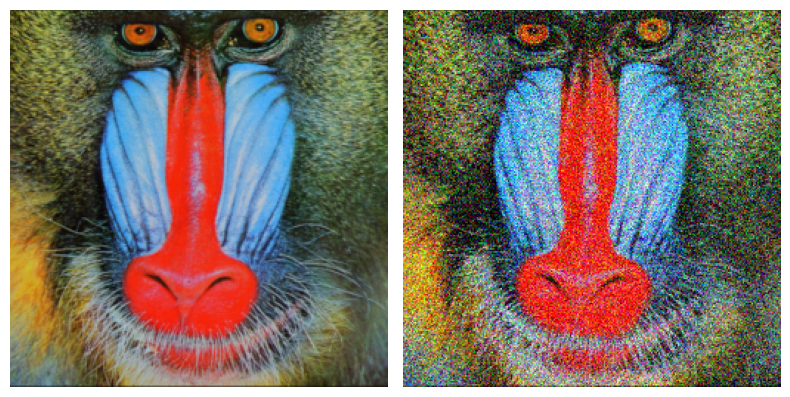

tensor(15.0015)


In [3]:
# clean = utils.load_celeba(30)
clean = utils.load_images('./data/CBSD68/')[:20]
# clean = utils.load_images('./data/Set14/')
# clean = utils.load_image("./data/set5/butterfly.png")
noisy = torch.stack([utils.get_noisy_image(img, 15) for img in clean])

utils.plot_row([clean[0], noisy[0]])

psnr = PeakSignalNoiseRatio(data_range=2)
print(psnr(noisy, clean))

In [4]:
# networks
net = UNetMod(hidden_ch=8, n_layers=4)

# losses
mse_ae = losses.Composed(losses.MSE(), losses.AE())
nmse_ae = losses.Composed(losses.NMSE(), losses.AE())

mse_tv = losses.Composed(losses.MSE(), losses.TV())
nmse_tv = losses.Composed(losses.NMSE(), losses.TV())

# variants
dip = DIP(net, losses.MSE())
dip_es = DIP(net, losses.MSE(), early_stopping=True)
dip_neighbor = DIP(net, losses.NMSE())
dip_neighbor_es = DIP(net, losses.NMSE(), early_stopping=True)
dip_tv = DIP(net, mse_tv)
dip_tv_es = DIP(net, mse_tv, early_stopping=True)

sgdip = SGDIP(net, mse_ae)
sgdip_es = SGDIP(net, mse_ae, early_stopping=True)
sgdip_neighbor = SGDIP(net, nmse_ae)
sgdip_neighbor_es = SGDIP(net, nmse_ae, early_stopping=True)

ddip = DDIP(net, losses.MSE(), schedules.Cos(0.1))
ddip_neighbor = DDIP(net, losses.NMSE(), schedules.Cos(0.1))

In [5]:
denoisers = [
    # SGDIP(net, mse_ae.with_alpha(0)),
    # SGDIP(net, mse_ae.with_alpha(0.1)),
    # SGDIP(net, mse_ae.with_alpha(1)),
    sgdip_es,
    SGDIP(net, mse_ae.with_alpha(schedules.Linear(1, 10))),
    dip_es,
    ddip,
]

metrics = {
    "psnr": PeakSignalNoiseRatio(data_range=2),
    "ssim": StructuralSimilarityIndexMeasure(data_range=2),
}

results = {}
for i, denoiser in enumerate(denoisers):
    outputs = []
    for j, (x_hat, x) in enumerate(zip(noisy, clean)):
        options = {
            "mode": "wandb",
            "config": {
                "project": "zero-shot-das-denoising",
                "entity": "jmaen-team",
                "group": "sgdip schedule 1",
                "dataset": "cbsd68-15",
                "denoiser_id": i,
                "data_id": j,
            },
            "metrics": metrics,
            "log_output": False,
        }
        output = denoiser.denoise(x_hat.unsqueeze(0), x.unsqueeze(0), options)
        output = output.detach().clone().cpu()
        outputs.append(output)

    results[f"{i} - {denoiser.name()}"] = torch.cat(outputs)

Running: 0 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 74%|███████▍  | 1486/2000 [02:30<00:51,  9.90it/s]


Running: 1 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 63%|██████▎   | 1252/2000 [02:04<01:14, 10.07it/s]


Running: 2 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 56%|█████▋    | 1128/2000 [01:52<01:26, 10.06it/s]


Running: 3 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 78%|███████▊  | 1552/2000 [02:39<00:46,  9.71it/s]


Running: 4 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 50%|████▉     | 994/2000 [01:36<01:38, 10.26it/s]


Running: 5 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 96%|█████████▋| 1928/2000 [03:16<00:07,  9.79it/s]


Running: 6 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 61%|██████    | 1221/2000 [02:05<01:20,  9.72it/s]


Running: 7 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 95%|█████████▌| 1906/2000 [03:18<00:09,  9.58it/s]


Running: 8 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 64%|██████▍   | 1287/2000 [02:08<01:11, 10.02it/s]


Running: 9 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 54%|█████▎    | 1073/2000 [01:51<01:36,  9.60it/s]


Running: 10 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 60%|██████    | 1203/2000 [01:59<01:19, 10.07it/s]


Running: 11 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 68%|██████▊   | 1356/2000 [02:17<01:05,  9.86it/s]


Running: 12 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 60%|█████▉    | 1193/2000 [01:59<01:20,  9.99it/s]


Running: 13 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 53%|█████▎    | 1065/2000 [01:52<01:38,  9.46it/s]


Running: 0 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:26<00:00,  9.70it/s]


Running: 1 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:22<00:00,  9.90it/s]


Running: 2 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:21<00:00,  9.91it/s]


Running: 3 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:13<00:00, 10.35it/s]


Running: 4 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:14<00:00, 10.27it/s]


Running: 5 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:16<00:00, 10.19it/s]


Running: 6 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:18<00:00, 10.07it/s]


Running: 7 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:15<00:00, 10.25it/s]


Running: 8 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:13<00:00, 10.33it/s]


Running: 9 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:14<00:00, 10.26it/s]


Running: 10 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:08<00:00, 10.63it/s]


Running: 11 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:24<00:00,  9.77it/s]


Running: 12 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:09<00:00, 10.53it/s]


Running: 13 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:21<00:00,  9.93it/s]


Running: 0 - DIP - ES - MSE - UNetMod 


 41%|████      | 813/2000 [00:30<00:44, 26.62it/s]


Running: 1 - DIP - ES - MSE - UNetMod 


 48%|████▊     | 963/2000 [00:33<00:36, 28.72it/s]


Running: 2 - DIP - ES - MSE - UNetMod 


 45%|████▌     | 907/2000 [00:33<00:40, 27.13it/s]


Running: 3 - DIP - ES - MSE - UNetMod 


 48%|████▊     | 962/2000 [00:34<00:37, 27.64it/s]


Running: 4 - DIP - ES - MSE - UNetMod 


 56%|█████▋    | 1126/2000 [00:41<00:32, 27.23it/s]


Running: 5 - DIP - ES - MSE - UNetMod 


 45%|████▌     | 902/2000 [00:31<00:38, 28.24it/s]


Running: 6 - DIP - ES - MSE - UNetMod 


 52%|█████▏    | 1032/2000 [00:48<00:45, 21.19it/s]


Running: 7 - DIP - ES - MSE - UNetMod 


 39%|███▉      | 787/2000 [00:28<00:44, 27.49it/s]


Running: 8 - DIP - ES - MSE - UNetMod 


 43%|████▎     | 852/2000 [00:30<00:41, 27.50it/s]


Running: 9 - DIP - ES - MSE - UNetMod 


 46%|████▌     | 910/2000 [00:32<00:39, 27.59it/s]


Running: 10 - DIP - ES - MSE - UNetMod 


 50%|█████     | 1003/2000 [00:36<00:36, 27.15it/s]


Running: 11 - DIP - ES - MSE - UNetMod 


 49%|████▉     | 977/2000 [00:37<00:39, 25.89it/s]


Running: 12 - DIP - ES - MSE - UNetMod 


 55%|█████▍    | 1097/2000 [00:41<00:34, 26.32it/s]


Running: 13 - DIP - ES - MSE - UNetMod 


 42%|████▏     | 835/2000 [00:32<00:45, 25.46it/s]


Running: 0 - DDIP (Cos) - MSE - UNetMod 


100%|██████████| 2000/2000 [01:13<00:00, 27.28it/s]


Running: 1 - DDIP (Cos) - MSE - UNetMod 


100%|██████████| 2000/2000 [01:13<00:00, 27.31it/s]


Running: 2 - DDIP (Cos) - MSE - UNetMod 


100%|██████████| 2000/2000 [01:10<00:00, 28.46it/s]


Running: 3 - DDIP (Cos) - MSE - UNetMod 


100%|██████████| 2000/2000 [01:10<00:00, 28.20it/s]


Running: 4 - DDIP (Cos) - MSE - UNetMod 


100%|██████████| 2000/2000 [01:11<00:00, 28.11it/s]


Running: 5 - DDIP (Cos) - MSE - UNetMod 


100%|██████████| 2000/2000 [01:12<00:00, 27.64it/s]


Running: 6 - DDIP (Cos) - MSE - UNetMod 


100%|██████████| 2000/2000 [01:11<00:00, 27.82it/s]


Running: 7 - DDIP (Cos) - MSE - UNetMod 


100%|██████████| 2000/2000 [01:13<00:00, 27.31it/s]


Running: 8 - DDIP (Cos) - MSE - UNetMod 


100%|██████████| 2000/2000 [01:13<00:00, 27.10it/s]


Running: 9 - DDIP (Cos) - MSE - UNetMod 


100%|██████████| 2000/2000 [01:13<00:00, 27.04it/s]


Running: 10 - DDIP (Cos) - MSE - UNetMod 


100%|██████████| 2000/2000 [01:13<00:00, 27.09it/s]


Running: 11 - DDIP (Cos) - MSE - UNetMod 


100%|██████████| 2000/2000 [01:13<00:00, 27.21it/s]


Running: 12 - DDIP (Cos) - MSE - UNetMod 


100%|██████████| 2000/2000 [01:13<00:00, 27.10it/s]


Running: 13 - DDIP (Cos) - MSE - UNetMod 


100%|██████████| 2000/2000 [01:13<00:00, 27.21it/s]


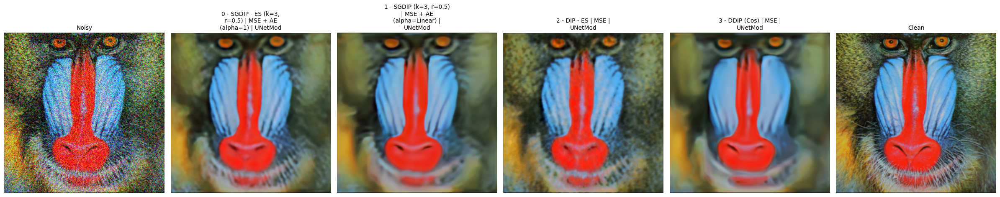

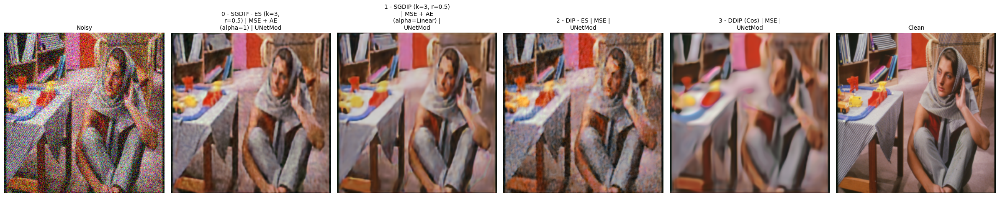

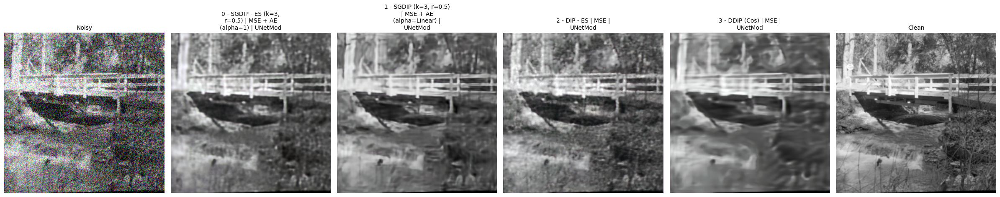

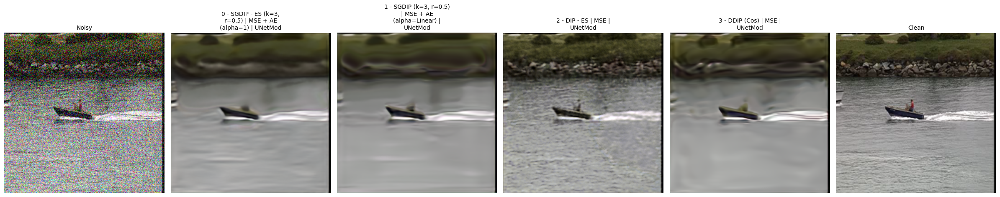

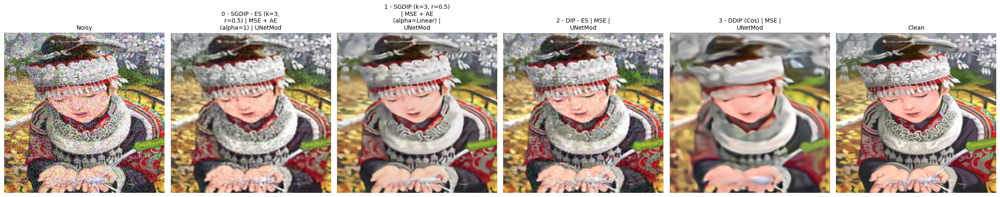

...

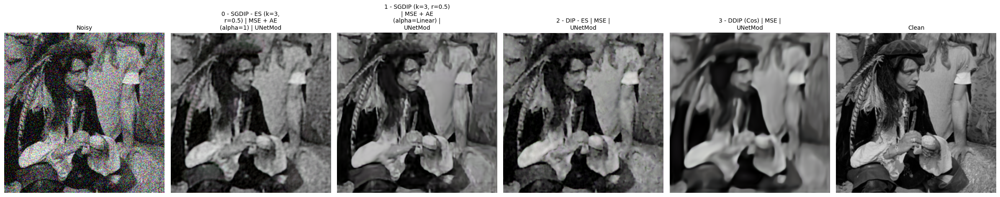

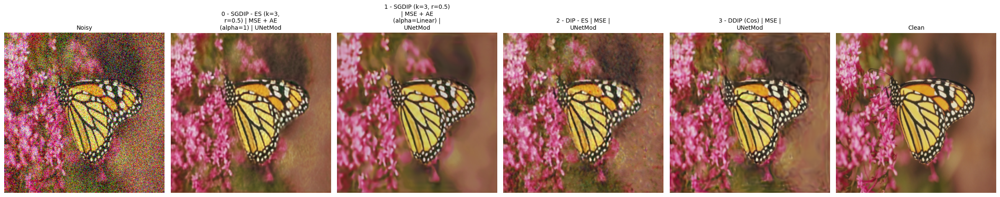

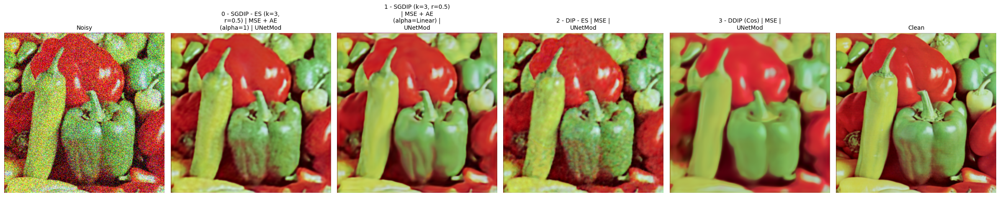

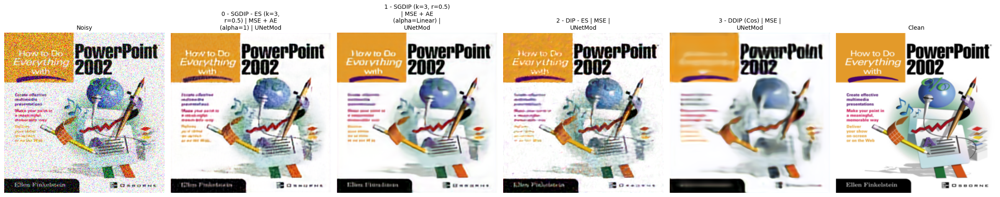

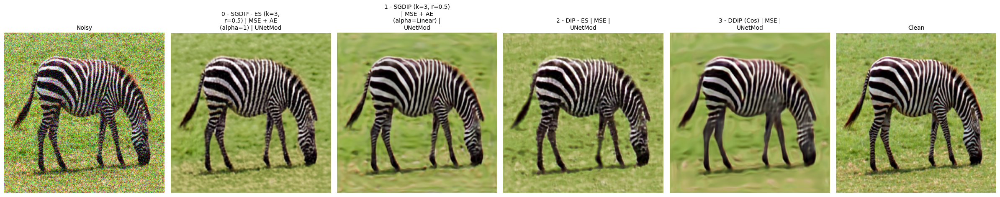

In [6]:
for result in zip(noisy, *results.values(), clean):
    utils.plot_row(result, ["Noisy", *list(results.keys()), "Clean"])

In [7]:
metrics = {
    "PSNR": PeakSignalNoiseRatio(data_range=2, reduction=None, dim=[1, 2, 3]),
    "SSIM": StructuralSimilarityIndexMeasure(data_range=2, reduction=None),
    # "LPIPS": LearnedPerceptualImagePatchSimilarity(),
}

for key, metric in metrics.items():
	print(key)
	print("----------")
	print(f"Noisy:".ljust(60), f"{metric(noisy, clean).mean()}")
	for name, xs in results.items():
		s = metric(xs, clean)
		print(f"{name}:".ljust(60), f"{s.mean()} ({s.var()})\t{s.tolist()}")
	print("\n")

PSNR
----------
Noisy:                                                       15.001545906066895
0 - SGDIP - ES (k=3, r=0.5) | MSE + AE (alpha=1) | UNetMod : 26.0322322845459 (4.542027473449707)	[23.204675674438477, 25.904245376586914, 25.181486129760742, 25.5636043548584, 22.53469467163086, 29.215681076049805, 24.568138122558594, 29.801523208618164, 28.51919937133789, 25.932931900024414, 26.314680099487305, 27.71372413635254, 25.25657081604004, 24.740114212036133]
1 - SGDIP (k=3, r=0.5) | MSE + AE (alpha=Linear) | UNetMod : 26.385540008544922 (3.8334860801696777)	[23.175209045410156, 26.33161163330078, 25.802608489990234, 25.599374771118164, 23.629249572753906, 28.752058029174805, 24.725189208984375, 29.901123046875, 28.586956024169922, 26.953500747680664, 26.58028221130371, 28.280128479003906, 25.660747528076172, 25.419536590576172]
2 - DIP - ES | MSE | UNetMod :                               25.158578872680664 (3.045403003692627)	[22.9666805267334, 24.670032501220703, 24.950273513793